In [20]:
import os
from datetime import datetime
from Const import *

In [21]:
import pandas as pd
import os
import plotly.graph_objects as go


In [23]:
def get_df(last_elem=0):
    all_subdirs = [d for d in os.listdir('Metrics/AttentionDQN/')]
    latest_subdir = max(all_subdirs)

    for i in range(last_elem):
        all_subdirs.pop(all_subdirs.index(latest_subdir))
        latest_subdir = max(all_subdirs)
    path = os.path.join('Metrics/AttentionDQN/', latest_subdir)
    filename = os.path.join(path, "distances_log.csv")

    df = pd.read_csv(filename)
    return df
df = get_df(1)

In [24]:
df.min().min()/AU

0.0006199953772058824

In [25]:
df = get_df()
print(df.min().min()/AU)
# px scatter all col of df :
fig = go.Figure()
# PLot lines
for i in range(0, len(df.columns)):
    fig.add_scatter(x=df.index, y=df[df.columns[i]]/AU, mode='lines', name=df.columns[i])
# Add title and labels
fig.update_layout(
    title="Distances",
    xaxis_title="Timesteps",
    yaxis_title="Distance (AU)",
    legend_title="Planets",
    font=dict(
        family="Courier New, monospace",
        size=18,
        color="RebeccaPurple"
    )
)

fig.show()

FileNotFoundError: [Errno 2] No such file or directory: 'Metrics/AttentionDQN/20250422-160149/distances_log.csv'

In [26]:
import numpy as np

# plot derivatives of columns of df:
def get_derivative(df):
    df = df.diff()
    return df

diff_df = get_derivative(df)
# px scatter all col of df :
fig = go.Figure()
# PLot lines
for i in range(0, len(diff_df.columns)):
    fig.add_scatter(x=diff_df.index, y=diff_df[diff_df.columns[i]]/AU, mode='lines', name='diff_'+diff_df.columns[i])
fig.show()


In [27]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots
# distances on 1 y-axis and derivatives on the other y-axis:
fig = make_subplots(specs=[[{"secondary_y": True}]])

# PLot lines
for i in range(0, len(diff_df.columns)):
    fig.add_scatter(x=diff_df.index, y=diff_df[diff_df.columns[i]]/AU, mode='lines', name='diff_'+diff_df.columns[i],  yaxis='y1')
    # plot df on other y-axis
    fig.add_scatter(x=df.index, y=df[df.columns[i]]/AU, mode='lines', name=df.columns[i], yaxis='y2')

fig.show()

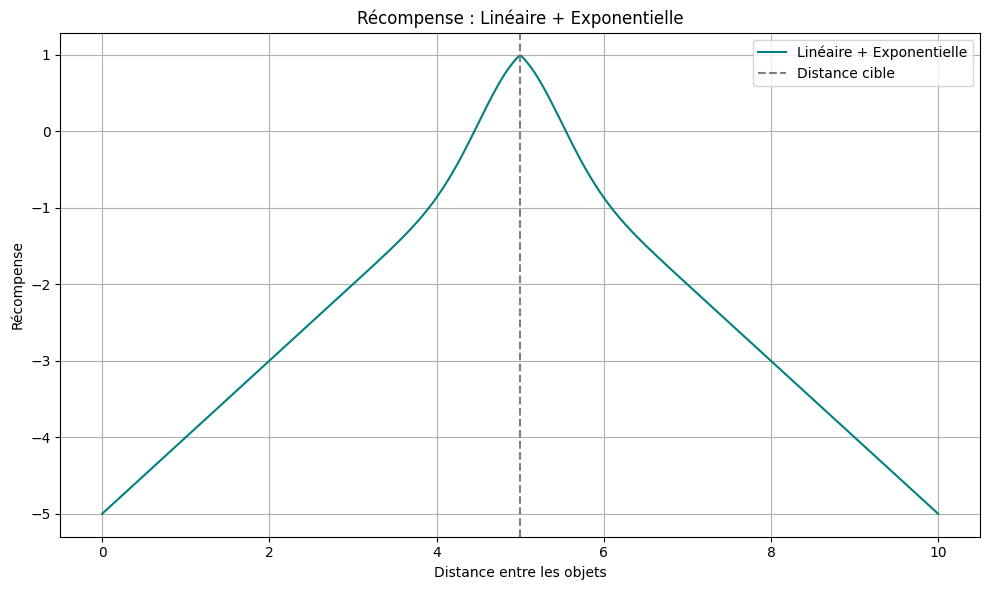

In [28]:
import numpy as np
import matplotlib.pyplot as plt

# Paramètres
d_target = 5
alpha = 2
distances = np.linspace(0, 10, 500)
error = distances - d_target

# Fonction : linéaire + exponentielle
reward = -np.abs(error) + np.exp(-alpha * error**2)

# Tracé
plt.figure(figsize=(10, 6))
plt.plot(distances, reward, label='Linéaire + Exponentielle', color='teal')
plt.axvline(d_target, color='grey', linestyle='--', label='Distance cible')
plt.title('Récompense : Linéaire + Exponentielle')
plt.xlabel('Distance entre les objets')
plt.ylabel('Récompense')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


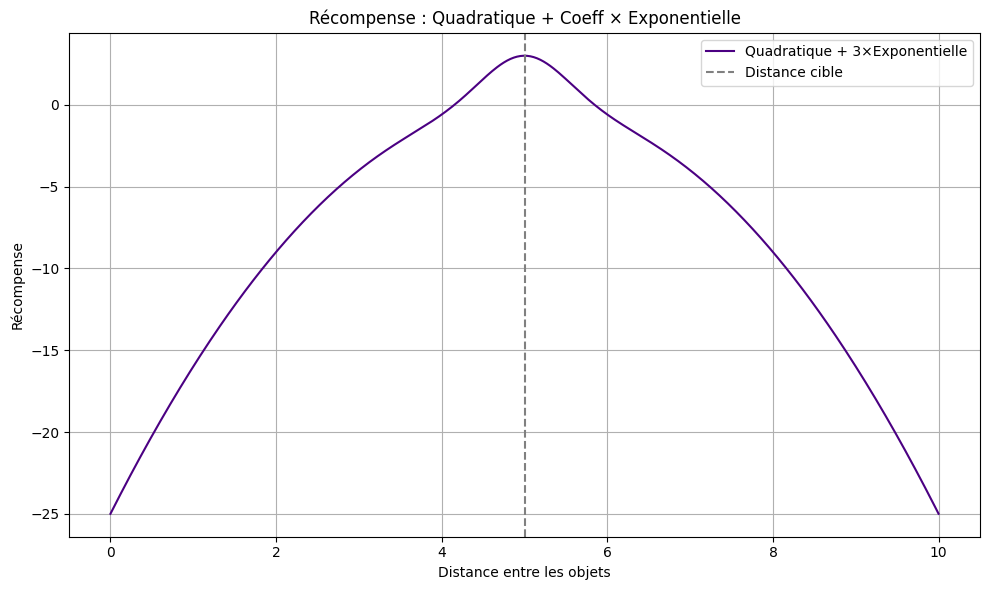

In [29]:
import numpy as np
import matplotlib.pyplot as plt

# Paramètres
d_target = 5                   # Distance cible
alpha = 2                      # Contrôle la forme de l'exponentielle
coeff = 3                      # Coefficient devant l'exponentielle
distances = np.linspace(0, 10, 500)

# Calcul de l'erreur
error = distances - d_target

# Fonction de récompense : quadratique + coefficient * exponentielle
reward = -error**2 + coeff * np.exp(-alpha * error**2)

# Tracé
plt.figure(figsize=(10, 6))
plt.plot(distances, reward, label=f'Quadratique + {coeff}×Exponentielle', color='indigo')
plt.axvline(d_target, color='grey', linestyle='--', label='Distance cible')
plt.title('Récompense : Quadratique + Coeff × Exponentielle')
plt.xlabel('Distance entre les objets')
plt.ylabel('Récompense')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


In [ ]:
import numpy as np
import plotly.graph_objects as go
# Paramètres
d_target = 5                   # Distance cible
alpha = 10                     # Contrôle la forme de l'exponentielle

distances = np.linspace(0, 10, 500)
# Calcul de l'erreur
error = distances - d_target
fig = go.Figure()
for coeff in range(1,15):
    # Fonction de récompense : quadratique + coefficient * exponentielle
    reward = -error**2 + coeff * np.exp(-alpha * error**2)

    fig.add_trace(go.Scatter(x = distances, y =reward))

fig.show()


In [ ]:
# --- Constants for Target Distance Reward Function ---
TARGET_DISTANCE_FACTOR = 5.0       # Target distance = TARGET_DISTANCE_FACTOR * planet_radius
# Scale factor for error (e.g., 1 million km = 1e9 meters, or adjust based on typical orbital scales)
DISTANCE_REWARD_SCALE_FACTOR = 1e9
# Alpha controls the sharpness of the peak reward (applied to scaled error)
REWARD_ALPHA = 10.0
# Coeff determines the max bonus reward at the target distance
REWARD_COEFF = 50.0                 # Example: Half of GOAL_REWARD

In [30]:
import math

current_distance = 1e7# Placeholder for current distance in meters

# --- Inside the Reward Calculation section in main.txt ---

# Calculate target distance based on planet radius (ensure radius is in meters)
# Assuming target_planet.radius is the scaled value for drawing
# We need the REAL radius. Let's approximate Earth's radius for now if needed,
# ideally you'd store real radii in your Planet objects or a lookup dictionary.
# Using Earth's approx radius in meters if target_planet.radius isn't real radius.
# It's better to add real radii (in meters) to your planet definitions!
# Example: target_planet_real_radius_m = PLANET_REAL_RADII.get(Target, 6.371e6) # Target is index
target_planet_real_radius_m = 6.371e6 # Placeholder - FIX THIS! Use actual target radius
d_target_m = target_planet_real_radius_m * TARGET_DISTANCE_FACTOR

# Calculate error in meters
error_m = current_distance - d_target_m

# Scale the error
scaled_error = error_m / DISTANCE_REWARD_SCALE_FACTOR

# Calculate the reward using the formula with scaled error
# Quadratic penalty term + Exponential bonus term
reward_distance = - (scaled_error**2) + REWARD_COEFF * math.exp(-REWARD_ALPHA * (scaled_error**2))
print(f"Reward Distance: {reward_distance}")
# Optional: Add a small overall scaling factor if needed
# reward_distance *= SOME_OVERALL_SCALE # e.g., 0.1 or 1.0

# Note: This reward_distance component replaces any previous distance-related calculations
# (like reward_improvement, penalty_worsening, penalty_absolute_distance from Alt 1)
# Make sure to adjust the total reward calculation accordingly:
# reward = reward_distance + reward_speed + reward_action + reward_time + reward_goal

Reward Distance: -1014.104025


In [32]:
# Open last training_log.csv and plot loss & avg_reward :
def get_logs(last_elem=0):
    all_subdirs = [d for d in os.listdir('Metrics/AttentionDQN/')]
    latest_subdir = max(all_subdirs)

    for i in range(last_elem):
        all_subdirs.pop(all_subdirs.index(latest_subdir))
        latest_subdir = max(all_subdirs)
    path = os.path.join('Metrics/AttentionDQN/', latest_subdir)
    filename = os.path.join(path, "training_log.csv")

    df = pd.read_csv(filename)
    return df
logs = get_logs(1)

In [ ]:
logs

,Episode,Steps,TotalReward,AverageLoss,Epsilon,GoalAchieved
0,1,1218,-1436.6488,531.372458,0.4764,False
1,2,3042,-2186.4432,508.048029,0.4233,False
2,3,746,-1594.1581,612.138620,0.4114,False
3,4,706,-1570.0389,598.243166,0.4006,False
4,5,753,-1710.5425,647.604044,0.3895,False
...,...,...,...,...,...,...
162,163,519,-1683.0605,1418.283203,0.1018,False
163,164,573,-1886.1975,1348.820467,0.1017,False
164,165,486,-1631.6995,1371.714078,0.1017,False
165,166,807,-1534.4080,1371.646830,0.1016,False


In [35]:
import plotly.express as px
# px scatter all AverageLoss :
px.scatter(logs,y='AverageLoss')

<Axes: >

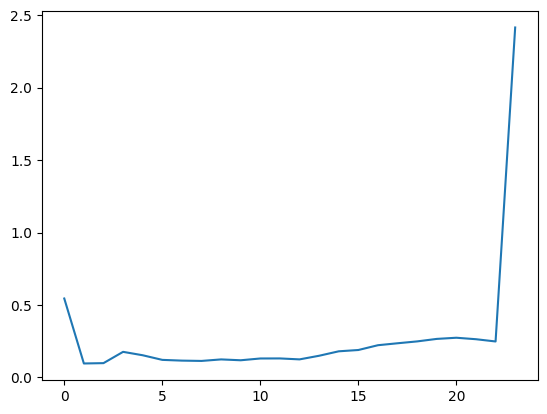

In [34]:
logs.AverageLoss.plot()

In [ ]:
import numpy as np

radius = 70e6
AU = 150e9
current_distance = np.arange(3*radius, AU, step = 299860000)
current_distance

array([2.1000000e+08, 5.0986000e+08, 8.0972000e+08, 1.1095800e+09,
       1.4094400e+09, 1.7093000e+09, 2.0091600e+09, 2.3090200e+09,
       2.6088800e+09, 2.9087400e+09, 3.2086000e+09, 3.5084600e+09,
       3.8083200e+09, 4.1081800e+09, 4.4080400e+09, 4.7079000e+09,
       5.0077600e+09, 5.3076200e+09, 5.6074800e+09, 5.9073400e+09,
       6.2072000e+09, 6.5070600e+09, 6.8069200e+09, 7.1067800e+09,
       7.4066400e+09, 7.7065000e+09, 8.0063600e+09, 8.3062200e+09,
       8.6060800e+09, 8.9059400e+09, 9.2058000e+09, 9.5056600e+09,
       9.8055200e+09, 1.0105380e+10, 1.0405240e+10, 1.0705100e+10,
       1.1004960e+10, 1.1304820e+10, 1.1604680e+10, 1.1904540e+10,
       1.2204400e+10, 1.2504260e+10, 1.2804120e+10, 1.3103980e+10,
       1.3403840e+10, 1.3703700e+10, 1.4003560e+10, 1.4303420e+10,
       1.4603280e+10, 1.4903140e+10, 1.5203000e+10, 1.5502860e+10,
       1.5802720e+10, 1.6102580e+10, 1.6402440e+10, 1.6702300e+10,
       1.7002160e+10, 1.7302020e+10, 1.7601880e+10, 1.7901740e

In [ ]:
thold = (np.subtract(current_distance, radius))
reward_distance = (np.divide(AU,thold))
reward_distance.shape

(500,)

In [ ]:
fig = go.Figure()
fig.add_trace(go.Scatter( y=reward_distance, mode='lines', name='Reward Distance'))

fig.show()